In [34]:
import tensorflow as tf
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt

from datasets.generative import get_small_utk_faces

In [35]:
X_train = get_small_utk_faces()
X_train = tf.cast(X_train, dtype=tf.dtypes.float32) / 127.5 - 1

print("Data in range: ", np.min(X_train), np.max(X_train))

Data in range:  -1.0 1.0


In [36]:
def plot_reconstructions(encoder_decoder, X):
    idxs = np.random.randint(0,X.shape[0], size=10)
    reconstruction, params = encoder_decoder.predict(tf.gather(X ,idxs))
    
    plt.figure(figsize=(16,3))
    for i in range(10):
        ax = plt.subplot(2,10,i+1)
        ax.imshow(X[idxs[i],:,:] * 0.5 + 0.5, interpolation=None)
        ax.axis("off")
        ax = plt.subplot(2,10,10+i+1)
        ax.imshow(reconstruction[i,:,:] * 0.5 + 0.5, interpolation=None)
        ax.axis("off")

    plt.show()

In [37]:
INTERMEDIATE_DIM = 200
LATENT_DIM = 150
EPOCHS = 100

### Reparametrization layer

This is the key layer in the VAE model. It takes a vector of lenght 2*_LATENT_DIM_, interpreting the first _LATENT_DIM_ features as the mean and the rest as the log variance. 

The log variance is used instead of the variance or std for numerical stability. Typicaly, standard deviation values will be small (1 >> $\sigma$ 0), which  magnifies the effect of floating point arithmetic errors. By using the log transform, we map these numerically unstable small numbers to a wider interval. Also, modeling the log variance naturally enforces positive variance values. Luckily, getting the std needed for the reparametrization from the modeled log variance is very simple, as $\sigma = \exp(\frac{1}{2} \log \sigma^2)$.

In [38]:
class SamplingLayer(keras.layers.Layer):
    
    def __init__(self, dimension):
        super(SamplingLayer, self).__init__()
        self._dimension = dimension
    
    def call(self, inputs):
        mean = inputs[:, :self._dimension]
        log_var = inputs[:, self._dimension:]
        std = tf.exp(0.5 * log_var)
        epsilon = tf.random.normal(tf.shape(mean))
        return mean +  std * epsilon

In [39]:
def build_encoder():
    encoder = tf.keras.Sequential()
    encoder.add(keras.layers.Conv2D(512, 4, strides=2, padding='same',
                                    input_shape=[32, 32, 3]))
    encoder.add(keras.layers.BatchNormalization())
    encoder.add(keras.layers.LeakyReLU())

    encoder.add(keras.layers.Conv2D(512, 4, strides=2, padding='same'))
    encoder.add(keras.layers.BatchNormalization())
    encoder.add(keras.layers.LeakyReLU())

    encoder.add(keras.layers.Conv2D(512, 4, strides=2, padding='same'))
    encoder.add(keras.layers.BatchNormalization())
    encoder.add(keras.layers.LeakyReLU())

    encoder.add(keras.layers.Flatten())

    encoder.add(keras.layers.Dense(INTERMEDIATE_DIM, activation="relu"))
    encoder.add(keras.layers.Dense(2 * LATENT_DIM, name="latent-mean-and-log-var"))
    return encoder

def build_decoder():
    decoder = tf.keras.Sequential()
    decoder.add(keras.layers.Input(2 * LATENT_DIM))
    decoder.add(SamplingLayer(LATENT_DIM))
    decoder.add(keras.layers.Dense(4*4*1024))
    decoder.add(keras.layers.LeakyReLU())
    decoder.add(keras.layers.Reshape((4, 4, 1024)))
    decoder.add(keras.layers.Conv2DTranspose(512, 4, strides=2, padding='same'))
    decoder.add(keras.layers.BatchNormalization())
    decoder.add(keras.layers.LeakyReLU())
    decoder.add(keras.layers.Conv2DTranspose(512, 4, strides=2, padding='same'))
    decoder.add(keras.layers.BatchNormalization())
    decoder.add(keras.layers.LeakyReLU())
    decoder.add(keras.layers.Conv2DTranspose(512, 4, strides=2, padding='same'))
    decoder.add(keras.layers.BatchNormalization())
    decoder.add(keras.layers.LeakyReLU())
    decoder.add(keras.layers.Conv2D(3, 3, padding='same', activation='tanh'))
    return decoder

In [40]:
encoder, decoder = build_encoder(), build_decoder()
encoder_decoder = keras.Model(encoder.inputs, [decoder(encoder.output)] + encoder.outputs)

### Kullback–Leibler loss

To enhance the continuity of the latent space, the VAE includes a KL-loss which pulls the distributions emited by the encoder towards the standard normal. This was nicely explained on Joseph Rocca's article on VAEs:

_The only fact that VAEs encode inputs as distributions instead of simple points is not sufficient to ensure continuity and completeness. Without a well defined regularisation term, the model can learn, in order to minimise its reconstruction error, to “ignore” the fact that distributions are returned and behave almost like classic autoencoders (leading to overfitting). To do so, the encoder can either return distributions with tiny variances (that would tend to be punctual distributions) or return distributions with very different means (that would then be really far apart from each other in the latent space). In both cases, distributions are used the wrong way (cancelling the expected benefit) and continuity and/or completeness are not satisfied.
So, in order to avoid these effects we have to regularise both the covariance matrix and the mean of the distributions returned by the encoder. In practice, this regularisation is done by enforcing distributions to be close to a standard normal distribution (centred and reduced). This way, we require the covariance matrices to be close to the identity, preventing punctual distributions, and the mean to be close to 0, preventing encoded distributions to be too far apart from each others._

REF: https://towardsdatascience.com/understanding-variational-autoencoders-vaes-f70510919f73

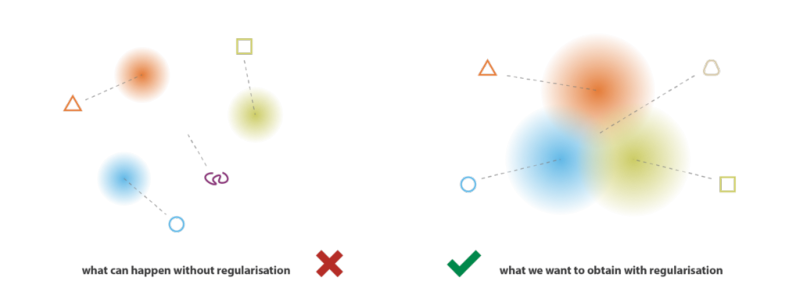

The KL-divergence of between a standard normal and a diagonal normal is given by:

$KL = \frac{1}{2} \sum_i (\mu_i^2 + \sigma_i^2 - \log \sigma^2 - 1)$  

Which can be easily codified as a loss function, given the mean and log variance vectors produced by the encoder.

REF: https://stats.stackexchange.com/questions/318748/deriving-the-kl-divergence-loss-for-vaes/370048#370048

In [41]:
def kl_loss(target, encoder_outputs):
    latent_dim = tf.cast((tf.shape(encoder_outputs)[1] / 2), "int32")
    mean = encoder_outputs[:, :latent_dim]
    log_var = tf.abs(encoder_outputs[:, latent_dim:])
    
    per_sample_kl_loss = 0.5 * tf.reduce_sum(tf.square(mean) + tf.exp(log_var) - log_var - 1, axis=1)
    return tf.reduce_mean(per_sample_kl_loss)

Regarding the reconstruction loss, the BCE (given that sample features are in [0,1]) and MSE are frequent choices. In the original VAE framework, the output of the decoder is not considered as a sample per se, but rather a parameter for a distribution, much like how the outputs of the encoder parametrize the normal in the sampling layer. Typicaly, the output of the decoder is considered to be the mean of a multi-dimensional normal of fixed std. This parametrized normal gives us the probability of observing any particular sample/image. Interestingly, in that case the minimization of the MSE corresponds to the Maximum Likelihood Estimate, and thus the minimization of the cross-entropy between the empirical distribution and p(x|z).

REFS:

https://towardsdatascience.com/variational-autoencoder-demystified-with-pytorch-implementation-3a06bee395ed

https://stats.stackexchange.com/questions/288451/why-is-mean-squared-error-the-cross-entropy-between-the-empirical-distribution-a


In [42]:
def reconstruction_loss(x, x_decoded):
    return tf.reduce_mean(tf.reduce_sum(tf.square(x - x_decoded), axis=[1,2,3]))

### Loss weights
The _loss_weights_ parameter constrols the relative weight of the reconstruction and KL losses. If the KL-loss weight is too high, samples are forced to
produce too similar latent codes, resulting in a high reconstruction error. If it is too low, the continuity and completeness of the latent space will be
affected, so interpollation between codes can be less meaningful.

In [43]:
encoder_decoder.compile(keras.optimizers.Adam(0.0001), loss=[reconstruction_loss, kl_loss], loss_weights=[1, 0.5])

1482/1482 [==============================] - 195s 132ms/step - loss: 248.5664 - sequential_9_loss: 208.0770 - latent-mean-and-log-var_loss: 80.9795
Original samples and reconstruction at epoch 0:


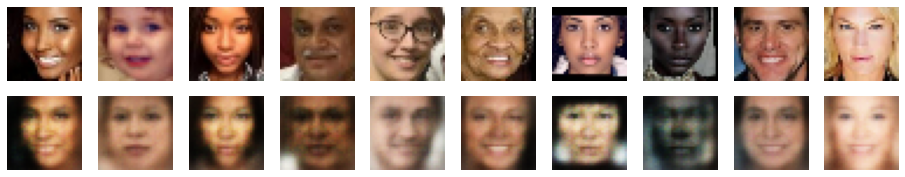

1482/1482 [==============================] - 201s 136ms/step - loss: 189.6589 - sequential_9_loss: 149.0255 - latent-mean-and-log-var_loss: 81.2669
Original samples and reconstruction at epoch 1:


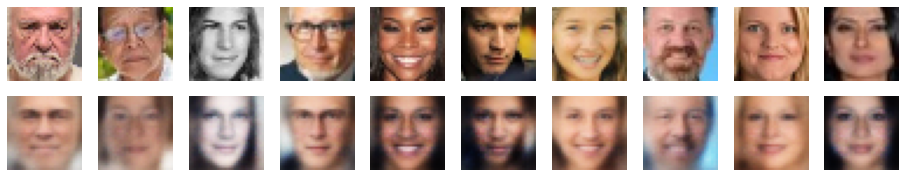

1482/1482 [==============================] - 201s 136ms/step - loss: 177.5208 - sequential_9_loss: 137.0413 - latent-mean-and-log-var_loss: 80.9591
Original samples and reconstruction at epoch 2:


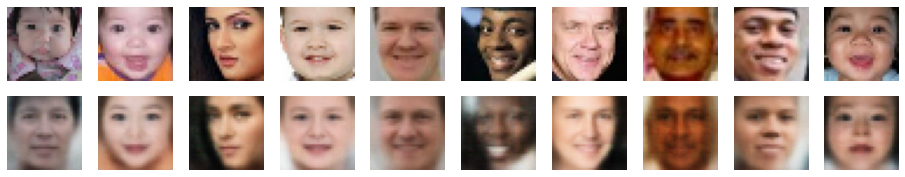

1482/1482 [==============================] - 202s 136ms/step - loss: 171.0044 - sequential_9_loss: 130.5121 - latent-mean-and-log-var_loss: 80.9848
Original samples and reconstruction at epoch 3:


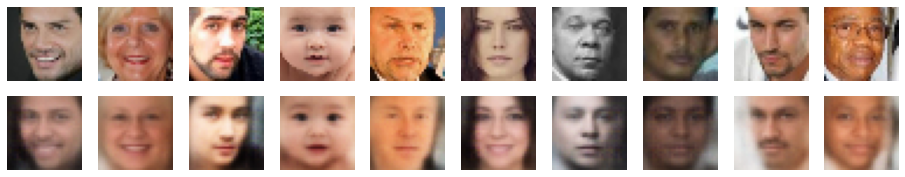

1482/1482 [==============================] - 202s 136ms/step - loss: 163.2399 - sequential_9_loss: 122.7191 - latent-mean-and-log-var_loss: 81.0412
Original samples and reconstruction at epoch 4:


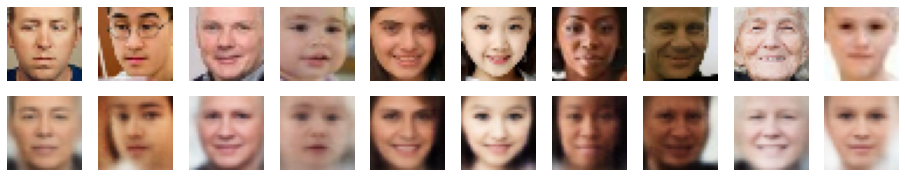

1482/1482 [==============================] - 202s 136ms/step - loss: 157.3122 - sequential_9_loss: 116.5535 - latent-mean-and-log-var_loss: 81.5175
Original samples and reconstruction at epoch 5:


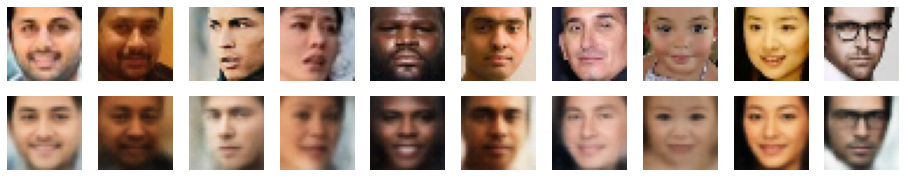

1482/1482 [==============================] - 202s 136ms/step - loss: 153.8676 - sequential_9_loss: 113.0313 - latent-mean-and-log-var_loss: 81.6729
Original samples and reconstruction at epoch 6:


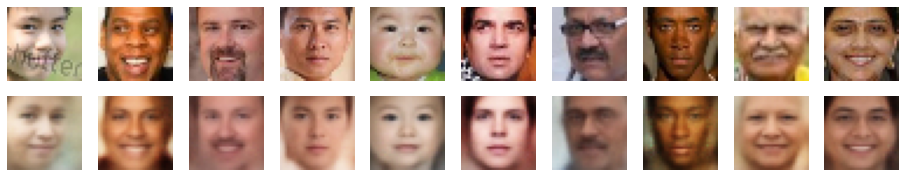

1482/1482 [==============================] - 201s 136ms/step - loss: 151.1965 - sequential_9_loss: 110.4406 - latent-mean-and-log-var_loss: 81.5119
Original samples and reconstruction at epoch 7:


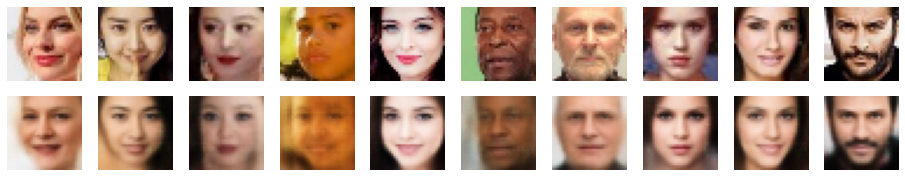

1482/1482 [==============================] - 201s 136ms/step - loss: 149.5182 - sequential_9_loss: 108.7224 - latent-mean-and-log-var_loss: 81.5914
Original samples and reconstruction at epoch 8:


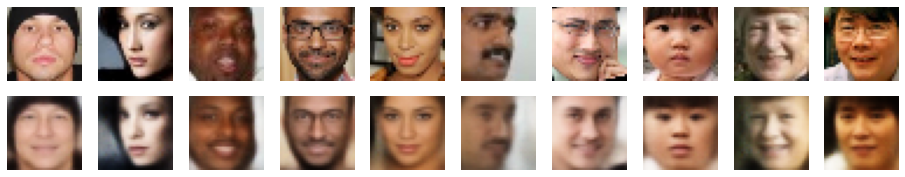

1482/1482 [==============================] - 202s 136ms/step - loss: 147.5184 - sequential_9_loss: 106.7774 - latent-mean-and-log-var_loss: 81.4822
Original samples and reconstruction at epoch 9:


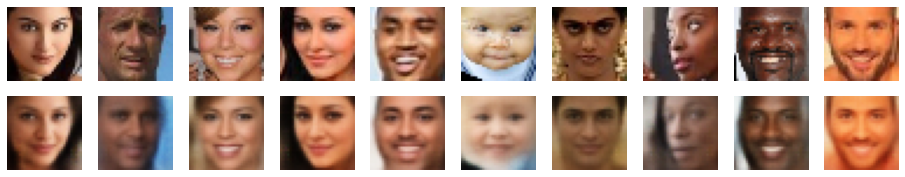

1482/1482 [==============================] - 202s 137ms/step - loss: 146.3314 - sequential_9_loss: 105.5307 - latent-mean-and-log-var_loss: 81.6013
Original samples and reconstruction at epoch 10:


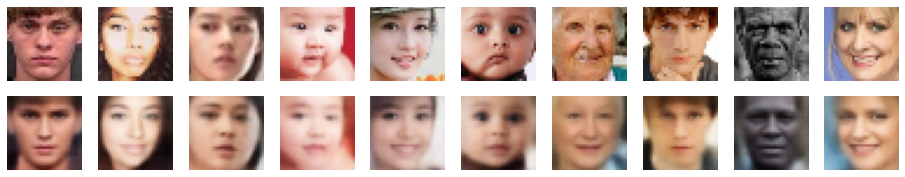

1482/1482 [==============================] - 202s 136ms/step - loss: 144.8845 - sequential_9_loss: 104.1113 - latent-mean-and-log-var_loss: 81.5465
Original samples and reconstruction at epoch 11:


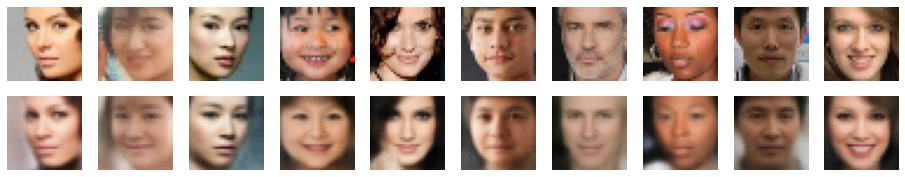

1482/1482 [==============================] - 201s 136ms/step - loss: 143.9124 - sequential_9_loss: 103.1686 - latent-mean-and-log-var_loss: 81.4876
Original samples and reconstruction at epoch 12:


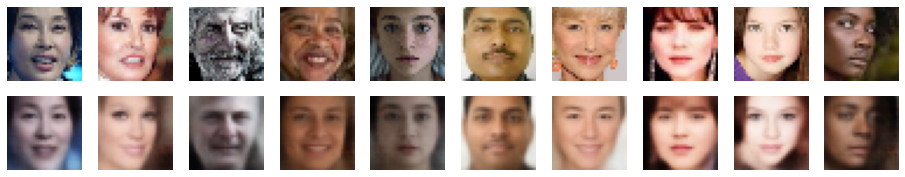

1482/1482 [==============================] - 202s 136ms/step - loss: 142.6672 - sequential_9_loss: 101.9442 - latent-mean-and-log-var_loss: 81.4456
Original samples and reconstruction at epoch 13:


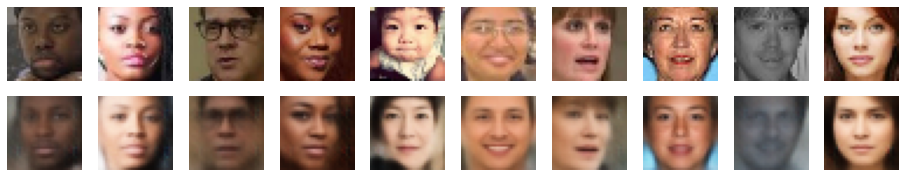

1482/1482 [==============================] - 202s 136ms/step - loss: 141.8102 - sequential_9_loss: 101.1038 - latent-mean-and-log-var_loss: 81.4129
Original samples and reconstruction at epoch 14:


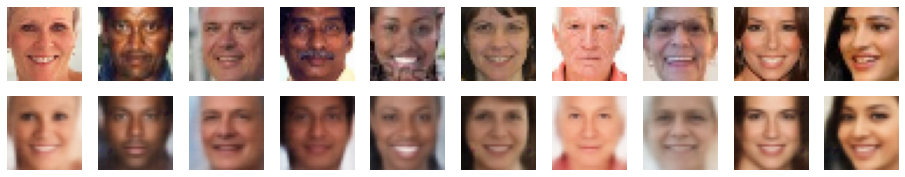

1482/1482 [==============================] - 202s 136ms/step - loss: 141.1114 - sequential_9_loss: 100.3537 - latent-mean-and-log-var_loss: 81.5154
Original samples and reconstruction at epoch 15:


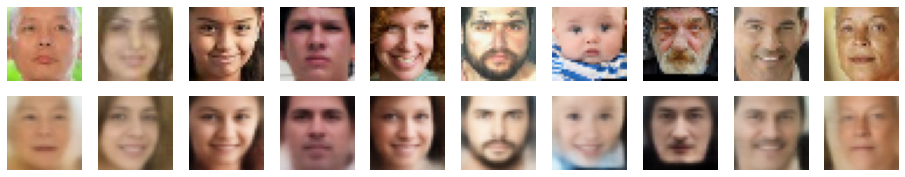

1482/1482 [==============================] - 201s 136ms/step - loss: 140.3647 - sequential_9_loss: 99.5760 - latent-mean-and-log-var_loss: 81.5773
Original samples and reconstruction at epoch 16:


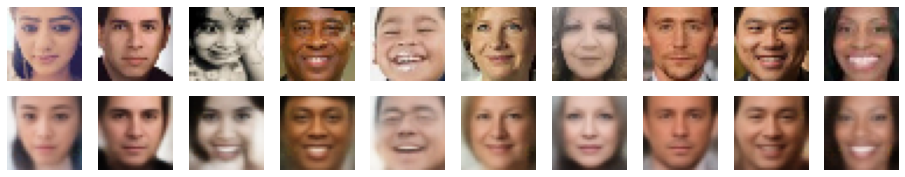

1482/1482 [==============================] - 201s 136ms/step - loss: 139.4763 - sequential_9_loss: 98.7464 - latent-mean-and-log-var_loss: 81.4599
Original samples and reconstruction at epoch 17:


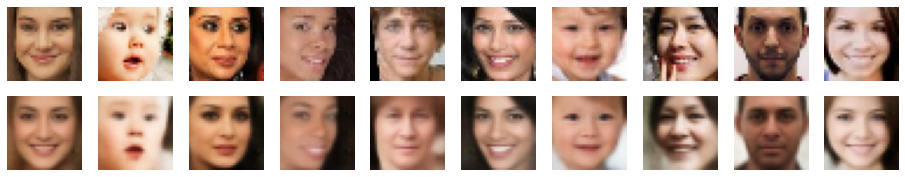

1482/1482 [==============================] - 202s 136ms/step - loss: 138.8751 - sequential_9_loss: 98.1439 - latent-mean-and-log-var_loss: 81.4625
Original samples and reconstruction at epoch 18:


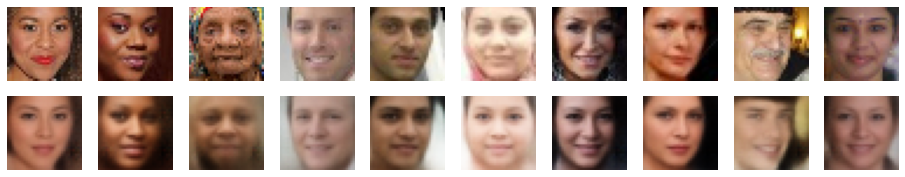

1482/1482 [==============================] - 202s 137ms/step - loss: 138.1060 - sequential_9_loss: 97.4137 - latent-mean-and-log-var_loss: 81.3848
Original samples and reconstruction at epoch 19:


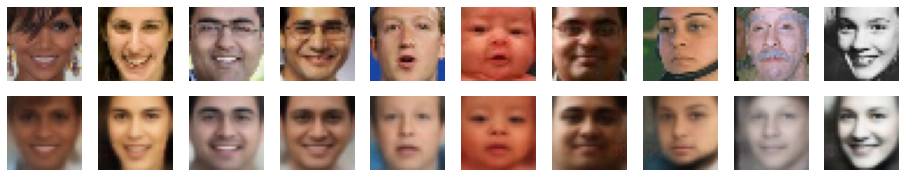

1482/1482 [==============================] - 202s 136ms/step - loss: 137.6000 - sequential_9_loss: 96.8335 - latent-mean-and-log-var_loss: 81.5330
Original samples and reconstruction at epoch 20:


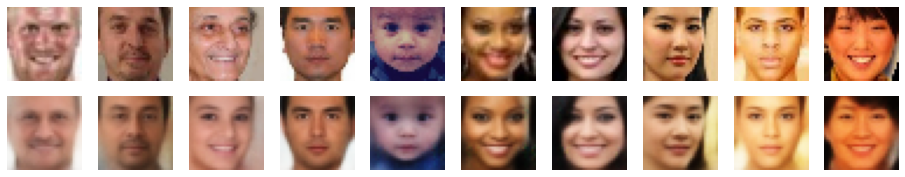

1482/1482 [==============================] - 202s 136ms/step - loss: 136.9932 - sequential_9_loss: 96.2801 - latent-mean-and-log-var_loss: 81.4264
Original samples and reconstruction at epoch 21:


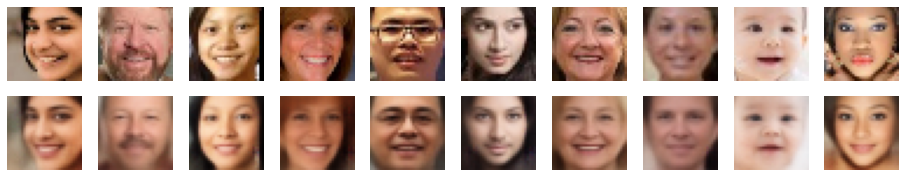

1482/1482 [==============================] - 201s 136ms/step - loss: 136.4794 - sequential_9_loss: 95.7540 - latent-mean-and-log-var_loss: 81.4507
Original samples and reconstruction at epoch 22:


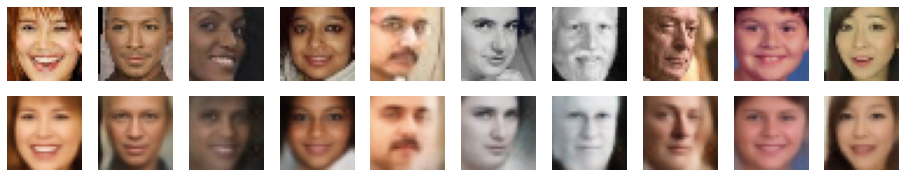

1482/1482 [==============================] - 201s 136ms/step - loss: 135.9150 - sequential_9_loss: 95.1979 - latent-mean-and-log-var_loss: 81.4345
Original samples and reconstruction at epoch 23:


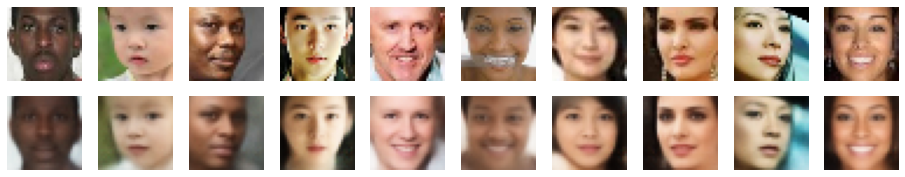

1482/1482 [==============================] - 202s 137ms/step - loss: 135.4987 - sequential_9_loss: 94.7789 - latent-mean-and-log-var_loss: 81.4392
Original samples and reconstruction at epoch 24:


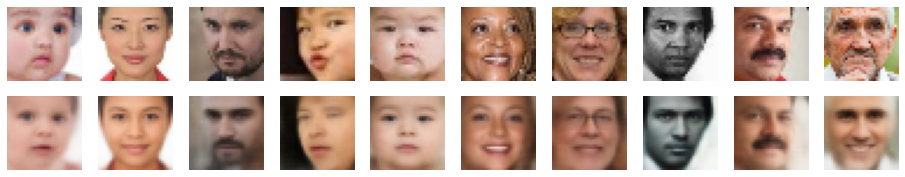

1482/1482 [==============================] - 202s 137ms/step - loss: 134.9938 - sequential_9_loss: 94.2307 - latent-mean-and-log-var_loss: 81.5261
Original samples and reconstruction at epoch 25:


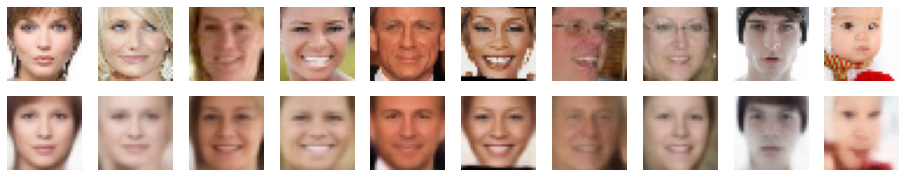

1482/1482 [==============================] - 202s 136ms/step - loss: 134.6938 - sequential_9_loss: 93.9019 - latent-mean-and-log-var_loss: 81.5841
Original samples and reconstruction at epoch 26:


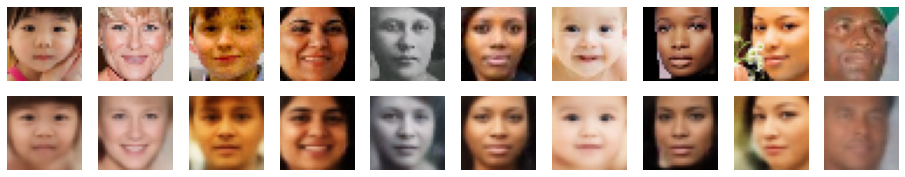

1482/1482 [==============================] - 202s 136ms/step - loss: 134.1236 - sequential_9_loss: 93.3746 - latent-mean-and-log-var_loss: 81.4980
Original samples and reconstruction at epoch 27:


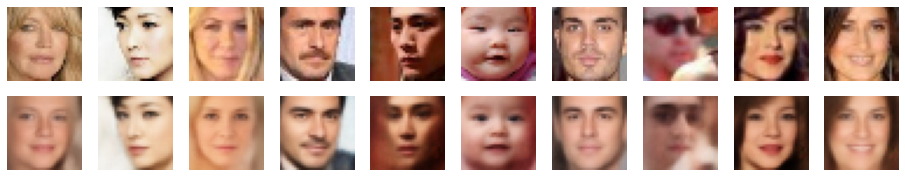

1482/1482 [==============================] - 201s 136ms/step - loss: 133.8104 - sequential_9_loss: 93.0266 - latent-mean-and-log-var_loss: 81.5678
Original samples and reconstruction at epoch 28:


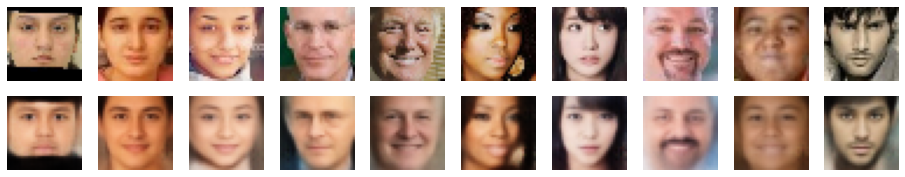

1482/1482 [==============================] - 202s 136ms/step - loss: 133.3853 - sequential_9_loss: 92.5894 - latent-mean-and-log-var_loss: 81.5915
Original samples and reconstruction at epoch 29:


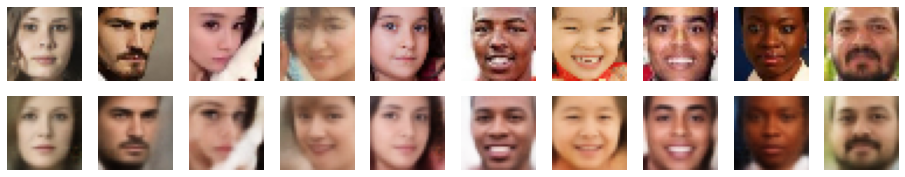

1482/1482 [==============================] - 203s 137ms/step - loss: 132.9953 - sequential_9_loss: 92.1762 - latent-mean-and-log-var_loss: 81.6383
Original samples and reconstruction at epoch 30:


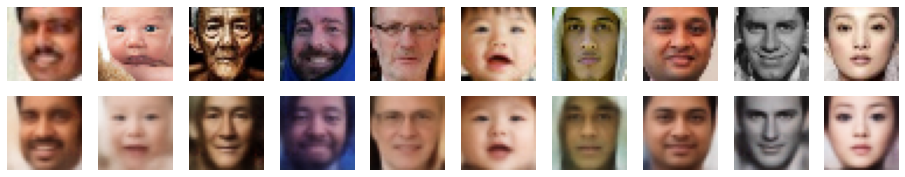

1482/1482 [==============================] - 202s 137ms/step - loss: 132.7448 - sequential_9_loss: 91.9260 - latent-mean-and-log-var_loss: 81.6373
Original samples and reconstruction at epoch 31:


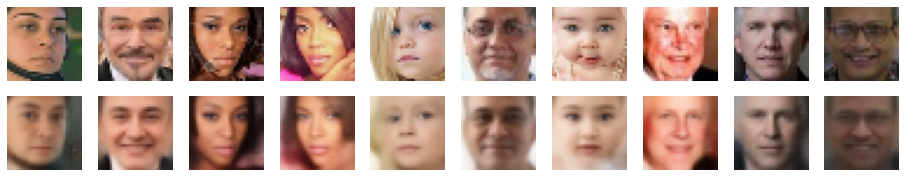

1482/1482 [==============================] - 202s 136ms/step - loss: 132.4377 - sequential_9_loss: 91.5652 - latent-mean-and-log-var_loss: 81.7445
Original samples and reconstruction at epoch 32:


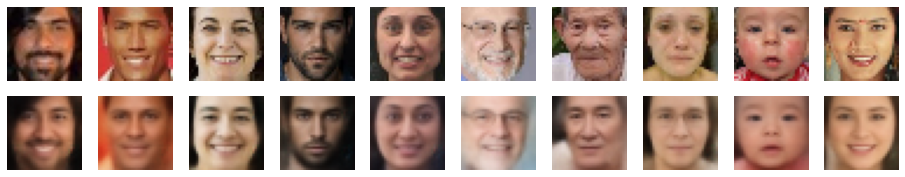

1482/1482 [==============================] - 202s 136ms/step - loss: 131.9839 - sequential_9_loss: 91.1641 - latent-mean-and-log-var_loss: 81.6398
Original samples and reconstruction at epoch 33:


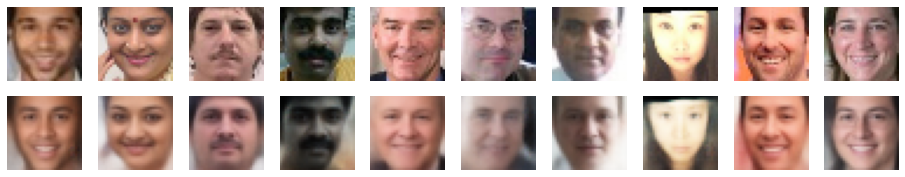

1482/1482 [==============================] - 202s 136ms/step - loss: 131.7458 - sequential_9_loss: 90.8725 - latent-mean-and-log-var_loss: 81.7463
Original samples and reconstruction at epoch 34:


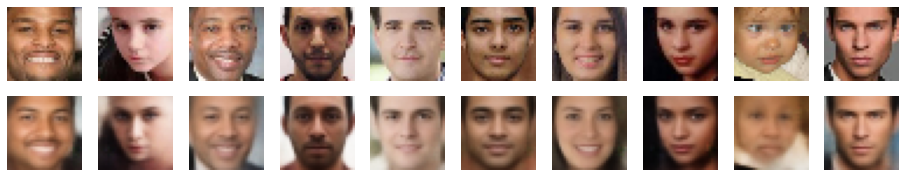

1482/1482 [==============================] - 202s 136ms/step - loss: 131.4051 - sequential_9_loss: 90.5408 - latent-mean-and-log-var_loss: 81.7286
Original samples and reconstruction at epoch 35:


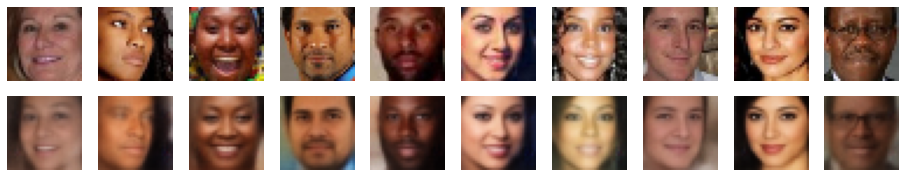

1482/1482 [==============================] - 201s 136ms/step - loss: 131.2058 - sequential_9_loss: 90.2973 - latent-mean-and-log-var_loss: 81.8171
Original samples and reconstruction at epoch 36:


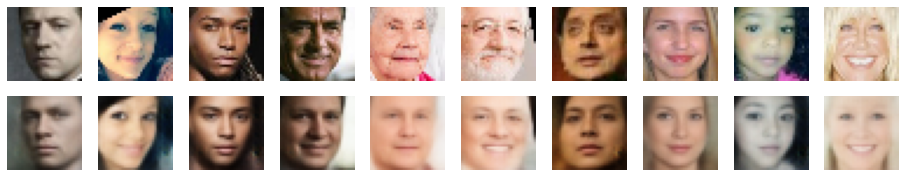

1482/1482 [==============================] - 201s 136ms/step - loss: 130.9043 - sequential_9_loss: 89.9708 - latent-mean-and-log-var_loss: 81.8670
Original samples and reconstruction at epoch 37:


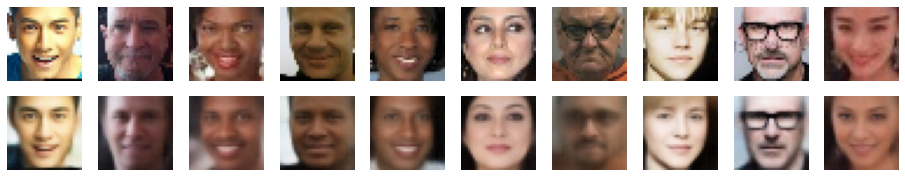

1482/1482 [==============================] - 201s 136ms/step - loss: 130.5403 - sequential_9_loss: 89.6422 - latent-mean-and-log-var_loss: 81.7969
Original samples and reconstruction at epoch 38:


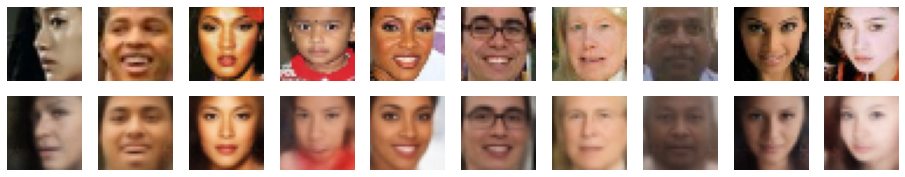

1482/1482 [==============================] - 202s 136ms/step - loss: 130.3035 - sequential_9_loss: 89.3604 - latent-mean-and-log-var_loss: 81.8865
Original samples and reconstruction at epoch 39:


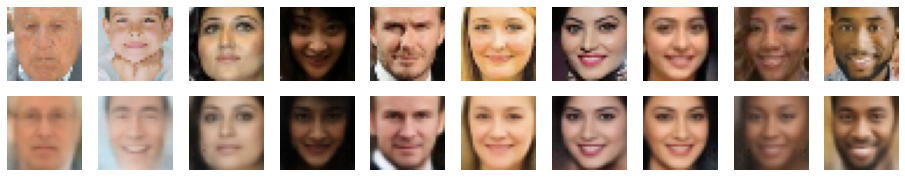

1482/1482 [==============================] - 202s 137ms/step - loss: 130.0299 - sequential_9_loss: 89.0906 - latent-mean-and-log-var_loss: 81.8788
Original samples and reconstruction at epoch 40:


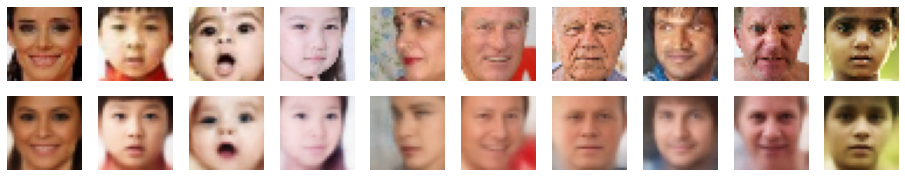

1482/1482 [==============================] - 202s 136ms/step - loss: 129.7245 - sequential_9_loss: 88.7505 - latent-mean-and-log-var_loss: 81.9478
Original samples and reconstruction at epoch 41:


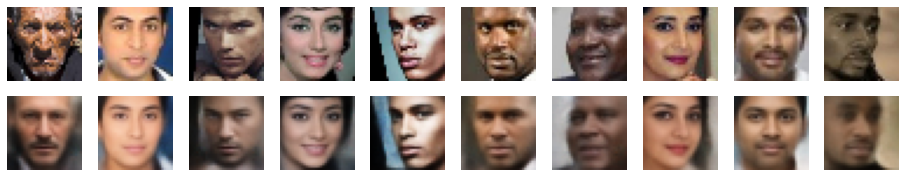

1482/1482 [==============================] - 202s 136ms/step - loss: 129.4720 - sequential_9_loss: 88.4978 - latent-mean-and-log-var_loss: 81.9487
Original samples and reconstruction at epoch 42:


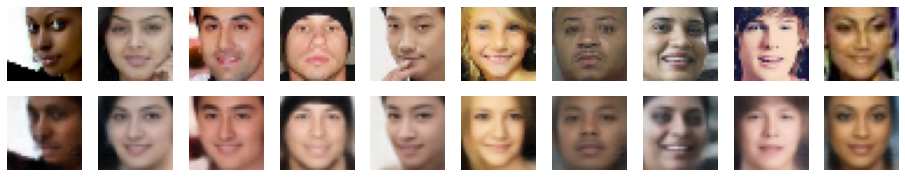

1482/1482 [==============================] - 201s 136ms/step - loss: 129.3386 - sequential_9_loss: 88.2916 - latent-mean-and-log-var_loss: 82.0939
Original samples and reconstruction at epoch 43:


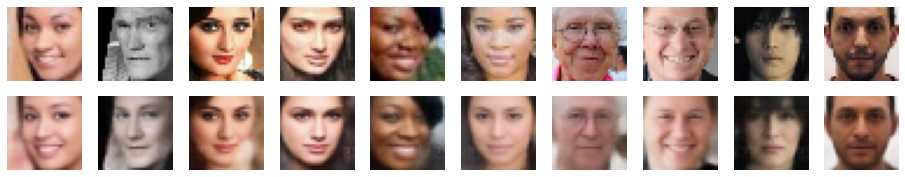

1482/1482 [==============================] - 201s 136ms/step - loss: 129.0027 - sequential_9_loss: 88.0152 - latent-mean-and-log-var_loss: 81.9748
Original samples and reconstruction at epoch 44:


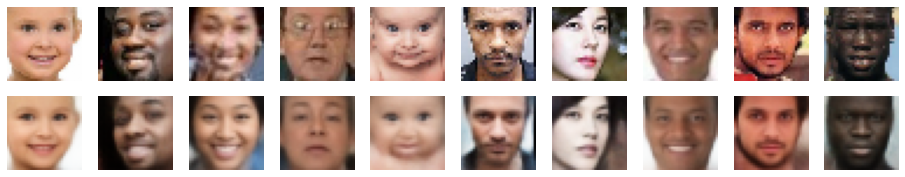

1482/1482 [==============================] - 202s 137ms/step - loss: 128.8049 - sequential_9_loss: 87.7837 - latent-mean-and-log-var_loss: 82.0422
Original samples and reconstruction at epoch 45:


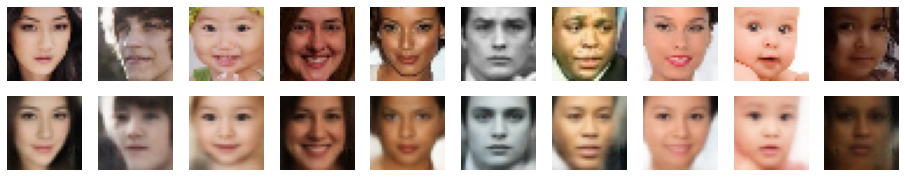

1482/1482 [==============================] - 202s 137ms/step - loss: 128.4942 - sequential_9_loss: 87.4761 - latent-mean-and-log-var_loss: 82.0366
Original samples and reconstruction at epoch 46:


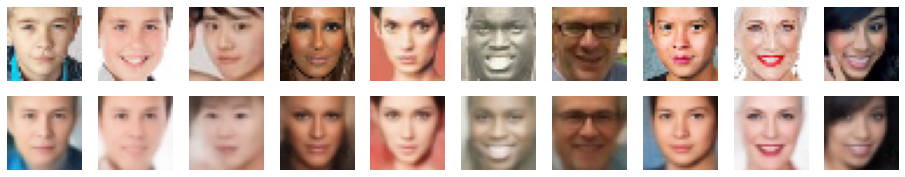

1482/1482 [==============================] - 202s 136ms/step - loss: 128.3164 - sequential_9_loss: 87.2624 - latent-mean-and-log-var_loss: 82.1079
Original samples and reconstruction at epoch 47:


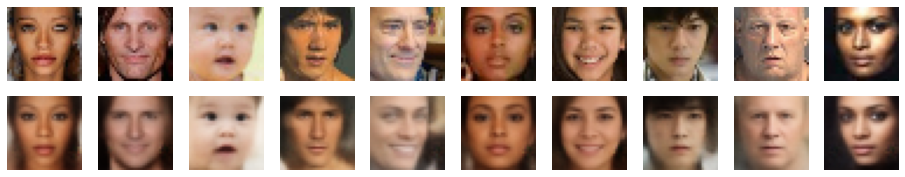

1482/1482 [==============================] - 202s 136ms/step - loss: 128.0908 - sequential_9_loss: 87.0299 - latent-mean-and-log-var_loss: 82.1214
Original samples and reconstruction at epoch 48:


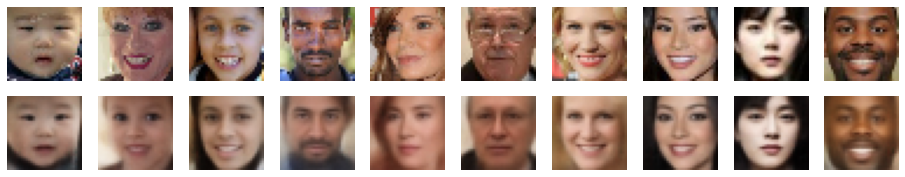

1482/1482 [==============================] - 201s 136ms/step - loss: 127.8815 - sequential_9_loss: 86.7748 - latent-mean-and-log-var_loss: 82.2133
Original samples and reconstruction at epoch 49:


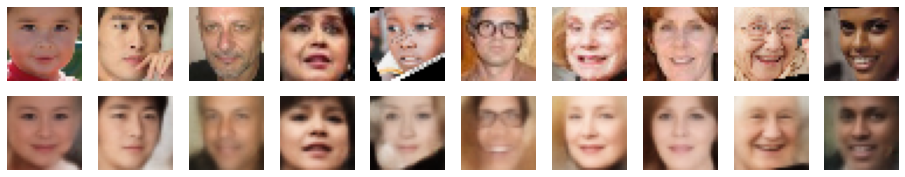

1482/1482 [==============================] - 201s 136ms/step - loss: 127.7225 - sequential_9_loss: 86.5896 - latent-mean-and-log-var_loss: 82.2659
Original samples and reconstruction at epoch 50:


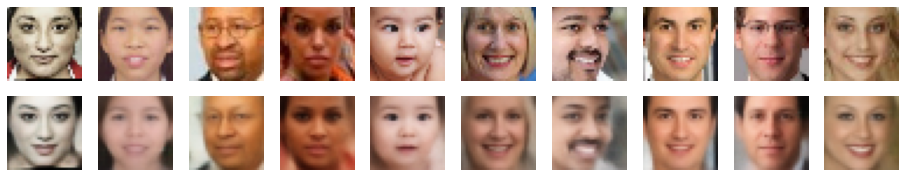

1482/1482 [==============================] - 202s 136ms/step - loss: 127.4741 - sequential_9_loss: 86.3606 - latent-mean-and-log-var_loss: 82.2269
Original samples and reconstruction at epoch 51:


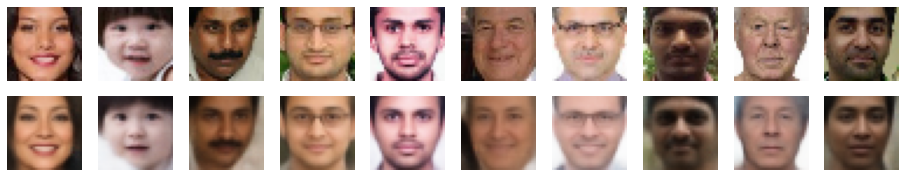

1482/1482 [==============================] - 202s 137ms/step - loss: 127.2005 - sequential_9_loss: 86.0561 - latent-mean-and-log-var_loss: 82.2885
Original samples and reconstruction at epoch 52:


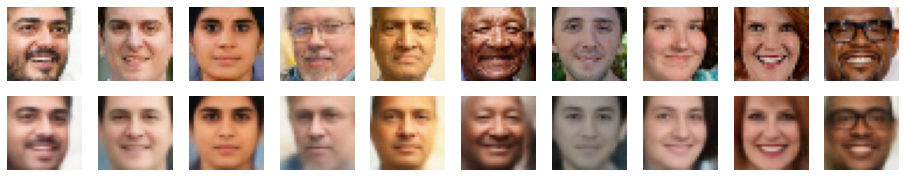

1482/1482 [==============================] - 201s 136ms/step - loss: 127.0537 - sequential_9_loss: 85.8717 - latent-mean-and-log-var_loss: 82.3644
Original samples and reconstruction at epoch 53:


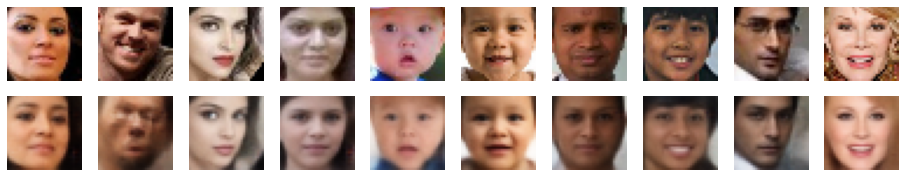

1482/1482 [==============================] - 201s 136ms/step - loss: 126.9634 - sequential_9_loss: 85.7333 - latent-mean-and-log-var_loss: 82.4603
Original samples and reconstruction at epoch 54:


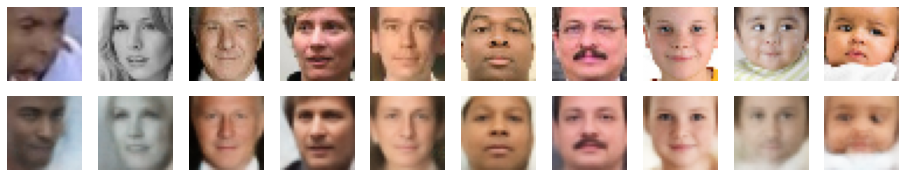

1482/1482 [==============================] - 203s 137ms/step - loss: 126.5657 - sequential_9_loss: 85.4193 - latent-mean-and-log-var_loss: 82.2932
Original samples and reconstruction at epoch 55:


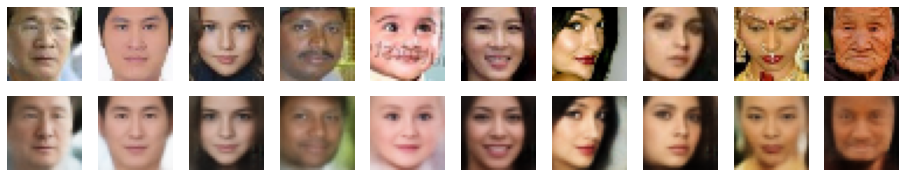

1482/1482 [==============================] - 202s 136ms/step - loss: 126.3646 - sequential_9_loss: 85.2213 - latent-mean-and-log-var_loss: 82.2865
Original samples and reconstruction at epoch 56:


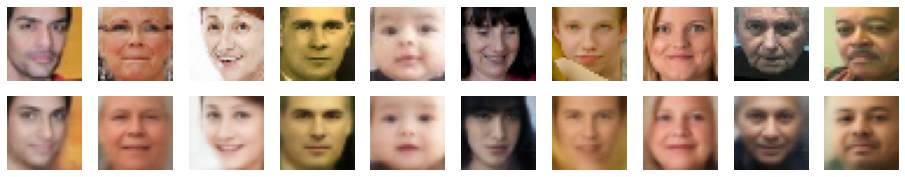

1482/1482 [==============================] - 202s 136ms/step - loss: 126.2366 - sequential_9_loss: 85.0411 - latent-mean-and-log-var_loss: 82.3913
Original samples and reconstruction at epoch 57:


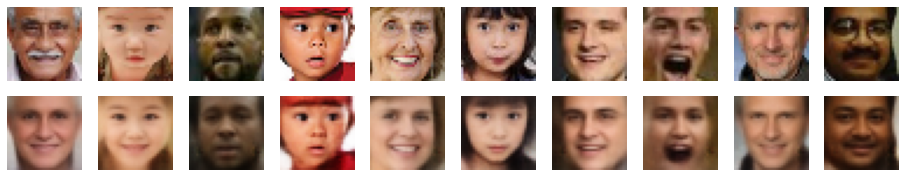

1482/1482 [==============================] - 201s 136ms/step - loss: 126.0885 - sequential_9_loss: 84.8685 - latent-mean-and-log-var_loss: 82.4404
Original samples and reconstruction at epoch 58:


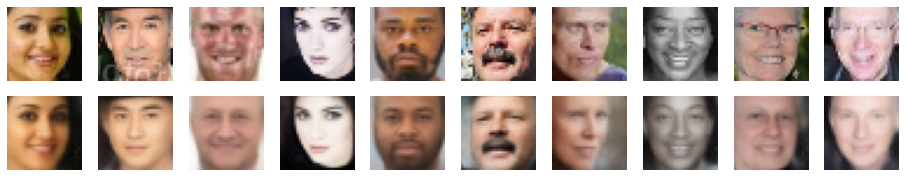

1482/1482 [==============================] - 201s 136ms/step - loss: 125.8878 - sequential_9_loss: 84.6743 - latent-mean-and-log-var_loss: 82.4271
Original samples and reconstruction at epoch 59:


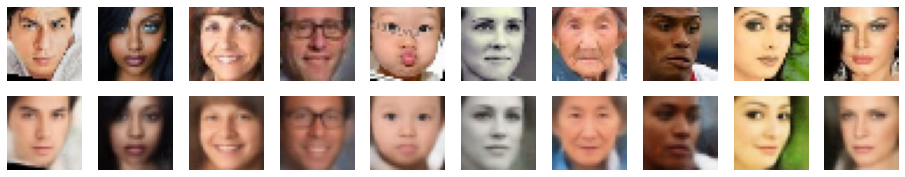

1482/1482 [==============================] - 202s 137ms/step - loss: 125.6633 - sequential_9_loss: 84.4380 - latent-mean-and-log-var_loss: 82.4503
Original samples and reconstruction at epoch 60:


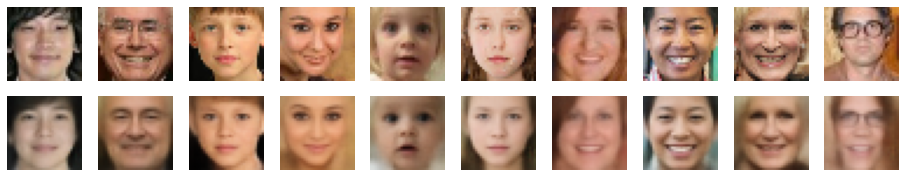

1482/1482 [==============================] - 202s 136ms/step - loss: 125.5560 - sequential_9_loss: 84.2712 - latent-mean-and-log-var_loss: 82.5695
Original samples and reconstruction at epoch 61:


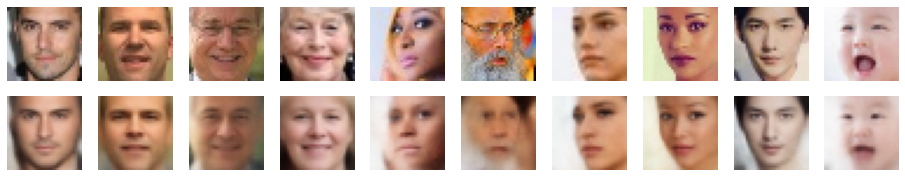

1482/1482 [==============================] - 202s 136ms/step - loss: 125.4306 - sequential_9_loss: 84.0882 - latent-mean-and-log-var_loss: 82.6850
Original samples and reconstruction at epoch 62:


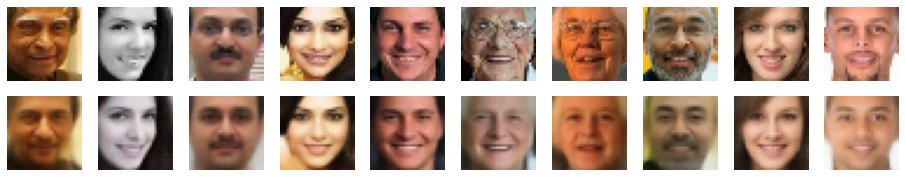

1482/1482 [==============================] - 202s 136ms/step - loss: 125.2333 - sequential_9_loss: 83.9215 - latent-mean-and-log-var_loss: 82.6236
Original samples and reconstruction at epoch 63:


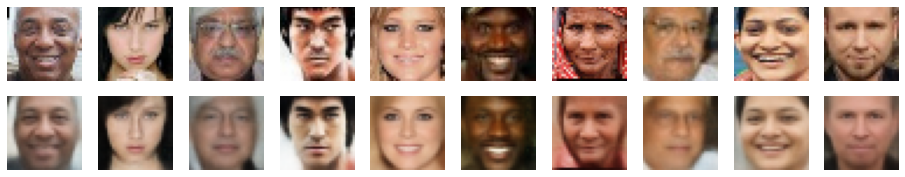

1482/1482 [==============================] - 202s 136ms/step - loss: 125.0779 - sequential_9_loss: 83.7294 - latent-mean-and-log-var_loss: 82.6974
Original samples and reconstruction at epoch 64:


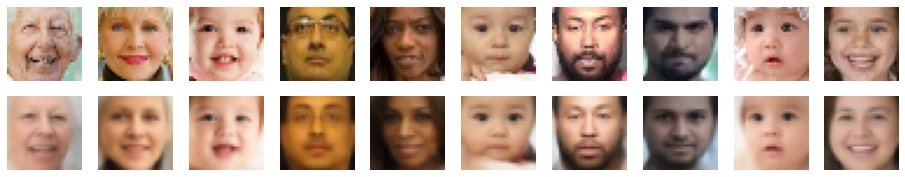

1482/1482 [==============================] - 201s 136ms/step - loss: 124.8422 - sequential_9_loss: 83.5131 - latent-mean-and-log-var_loss: 82.6583
Original samples and reconstruction at epoch 65:


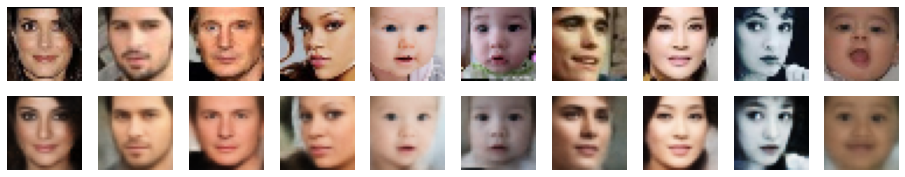

1482/1482 [==============================] - 201s 136ms/step - loss: 124.6167 - sequential_9_loss: 83.3131 - latent-mean-and-log-var_loss: 82.6072
Original samples and reconstruction at epoch 66:


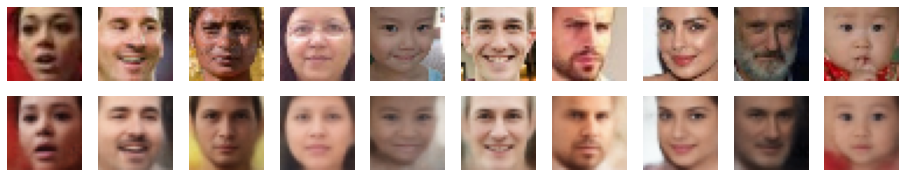

1482/1482 [==============================] - 201s 136ms/step - loss: 124.4990 - sequential_9_loss: 83.1698 - latent-mean-and-log-var_loss: 82.6587
Original samples and reconstruction at epoch 67:


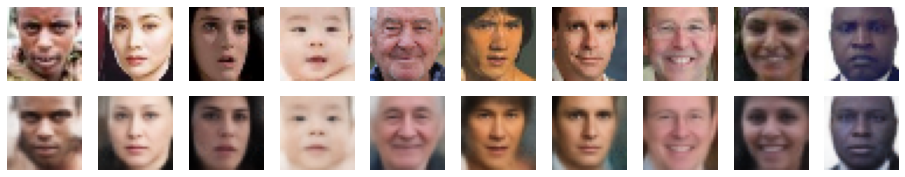

1482/1482 [==============================] - 202s 137ms/step - loss: 124.3175 - sequential_9_loss: 82.9894 - latent-mean-and-log-var_loss: 82.6559
Original samples and reconstruction at epoch 68:


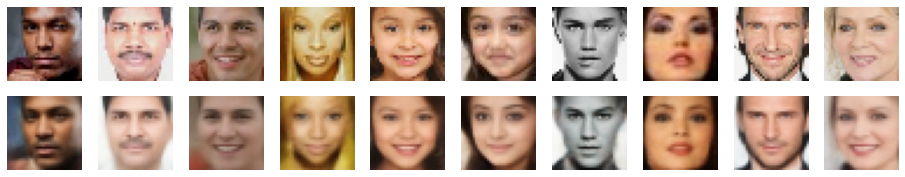

1482/1482 [==============================] - 202s 137ms/step - loss: 124.2316 - sequential_9_loss: 82.8506 - latent-mean-and-log-var_loss: 82.7620
Original samples and reconstruction at epoch 69:


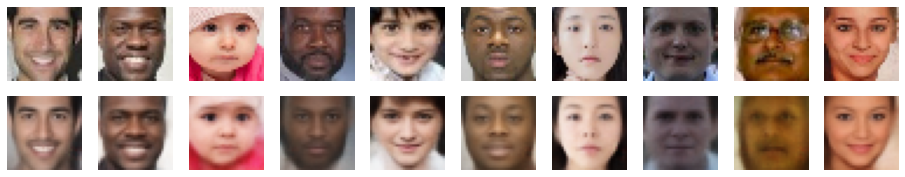

1482/1482 [==============================] - 202s 136ms/step - loss: 124.0528 - sequential_9_loss: 82.6114 - latent-mean-and-log-var_loss: 82.8823
Original samples and reconstruction at epoch 70:


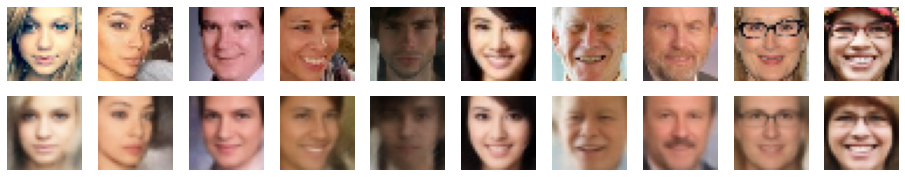

1482/1482 [==============================] - 202s 136ms/step - loss: 123.8882 - sequential_9_loss: 82.4836 - latent-mean-and-log-var_loss: 82.8091
Original samples and reconstruction at epoch 71:


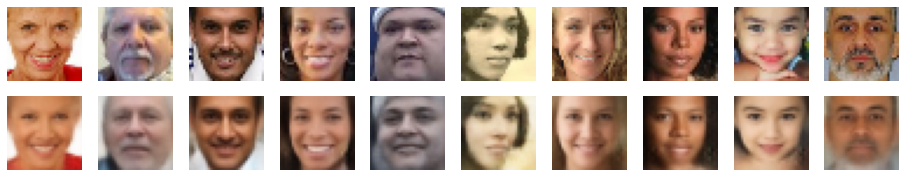

1482/1482 [==============================] - 201s 136ms/step - loss: 123.7071 - sequential_9_loss: 82.2801 - latent-mean-and-log-var_loss: 82.8541
Original samples and reconstruction at epoch 72:


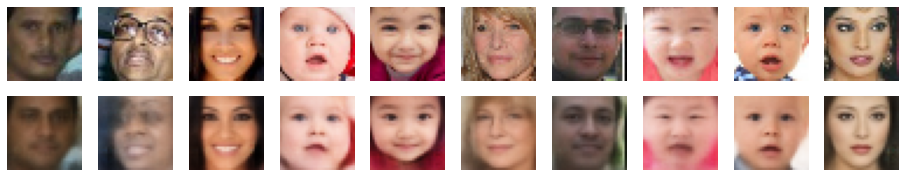

1482/1482 [==============================] - 201s 136ms/step - loss: 123.5905 - sequential_9_loss: 82.1200 - latent-mean-and-log-var_loss: 82.9410
Original samples and reconstruction at epoch 73:


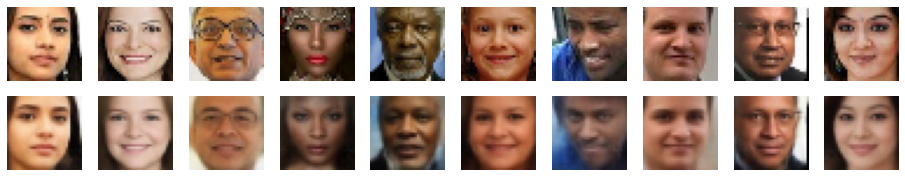

1482/1482 [==============================] - 202s 136ms/step - loss: 123.3637 - sequential_9_loss: 81.9407 - latent-mean-and-log-var_loss: 82.8459
Original samples and reconstruction at epoch 74:


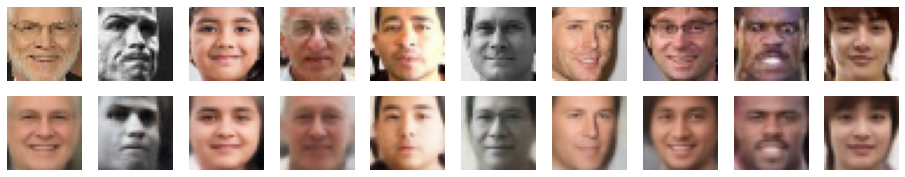

1482/1482 [==============================] - 202s 137ms/step - loss: 123.2443 - sequential_9_loss: 81.7753 - latent-mean-and-log-var_loss: 82.9379
Original samples and reconstruction at epoch 75:


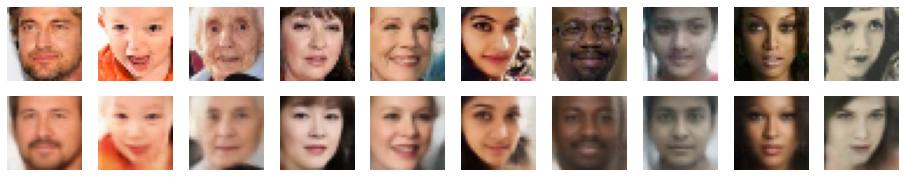

1482/1482 [==============================] - 202s 136ms/step - loss: 123.1375 - sequential_9_loss: 81.6542 - latent-mean-and-log-var_loss: 82.9664
Original samples and reconstruction at epoch 76:


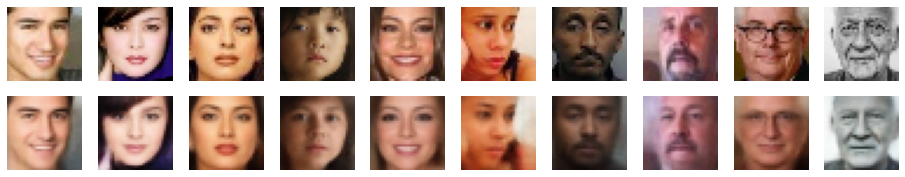

1482/1482 [==============================] - 202s 136ms/step - loss: 122.9482 - sequential_9_loss: 81.4616 - latent-mean-and-log-var_loss: 82.9733
Original samples and reconstruction at epoch 77:


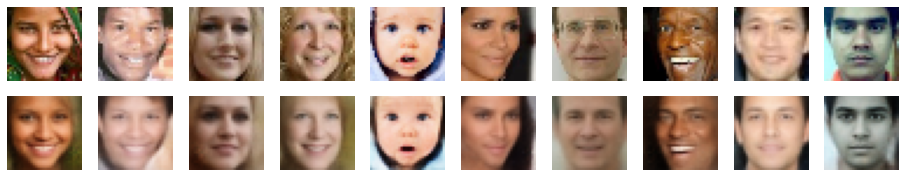

1482/1482 [==============================] - 201s 136ms/step - loss: 122.8247 - sequential_9_loss: 81.3454 - latent-mean-and-log-var_loss: 82.9587
Original samples and reconstruction at epoch 78:


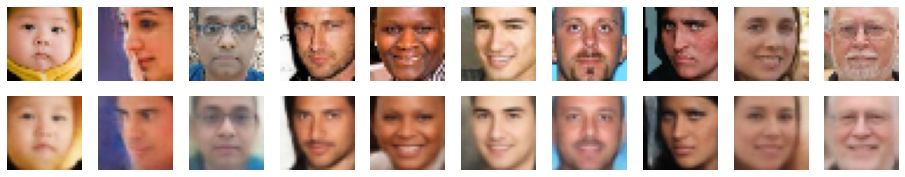

1482/1482 [==============================] - 201s 136ms/step - loss: 122.7367 - sequential_9_loss: 81.1988 - latent-mean-and-log-var_loss: 83.0758
Original samples and reconstruction at epoch 79:


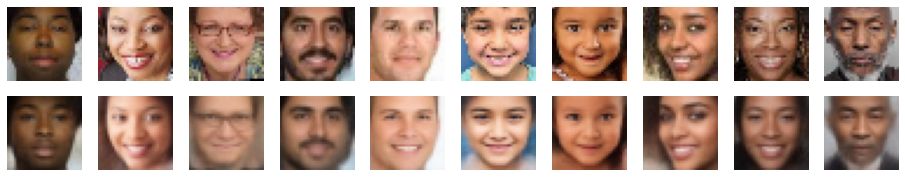

1482/1482 [==============================] - 202s 136ms/step - loss: 122.5814 - sequential_9_loss: 81.0798 - latent-mean-and-log-var_loss: 83.0032
Original samples and reconstruction at epoch 80:


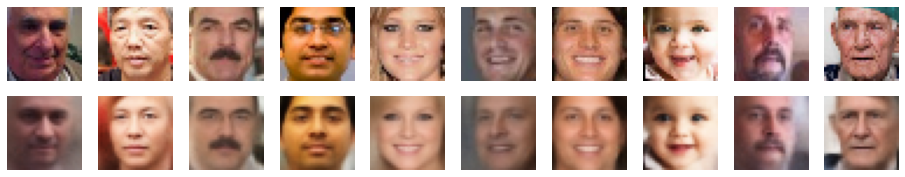

1482/1482 [==============================] - 202s 137ms/step - loss: 122.4112 - sequential_9_loss: 80.8964 - latent-mean-and-log-var_loss: 83.0296
Original samples and reconstruction at epoch 81:


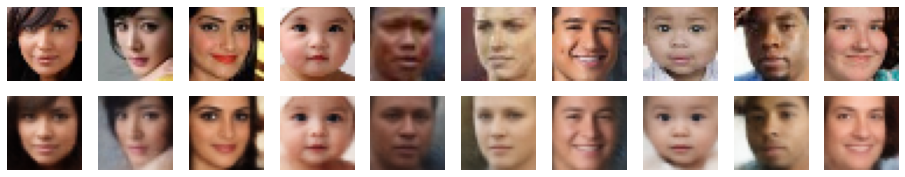

1482/1482 [==============================] - 202s 136ms/step - loss: 122.3544 - sequential_9_loss: 80.7940 - latent-mean-and-log-var_loss: 83.1207
Original samples and reconstruction at epoch 82:


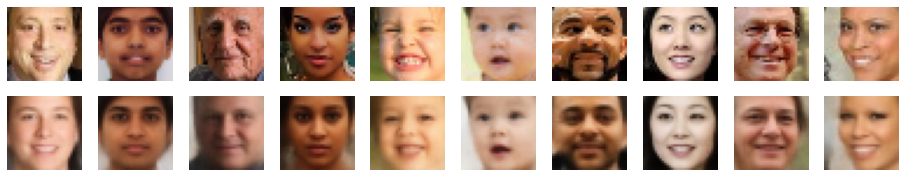

1482/1482 [==============================] - 201s 136ms/step - loss: 122.1518 - sequential_9_loss: 80.5870 - latent-mean-and-log-var_loss: 83.1299
Original samples and reconstruction at epoch 83:


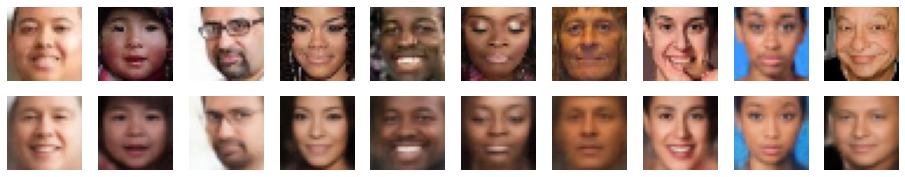

1482/1482 [==============================] - 201s 136ms/step - loss: 122.0900 - sequential_9_loss: 80.4610 - latent-mean-and-log-var_loss: 83.2579
Original samples and reconstruction at epoch 84:


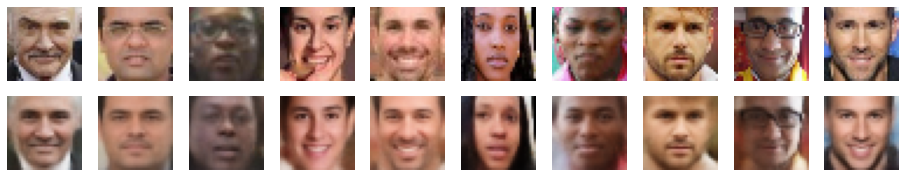

1482/1482 [==============================] - 202s 136ms/step - loss: 121.8915 - sequential_9_loss: 80.3197 - latent-mean-and-log-var_loss: 83.1435
Original samples and reconstruction at epoch 85:


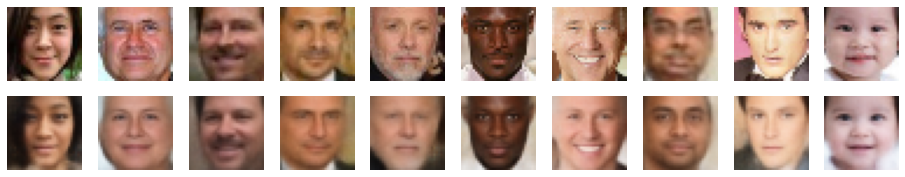

1482/1482 [==============================] - 202s 136ms/step - loss: 121.7567 - sequential_9_loss: 80.1548 - latent-mean-and-log-var_loss: 83.2038
Original samples and reconstruction at epoch 86:


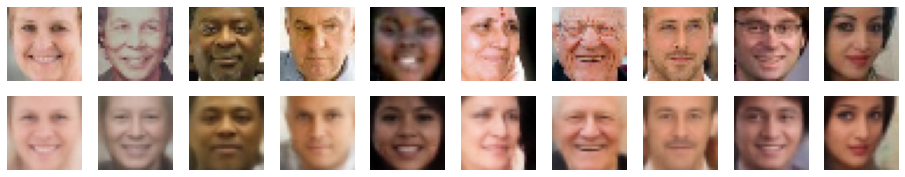

1482/1482 [==============================] - 202s 136ms/step - loss: 121.5524 - sequential_9_loss: 79.9983 - latent-mean-and-log-var_loss: 83.1084
Original samples and reconstruction at epoch 87:


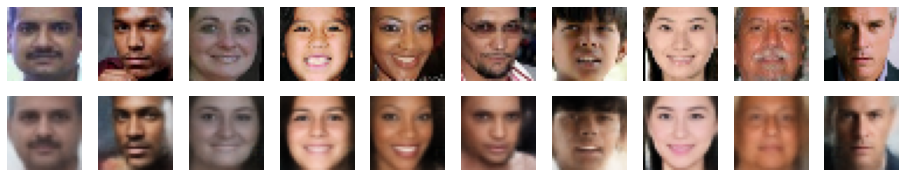

1482/1482 [==============================] - 202s 136ms/step - loss: 121.5498 - sequential_9_loss: 79.9084 - latent-mean-and-log-var_loss: 83.2829
Original samples and reconstruction at epoch 88:


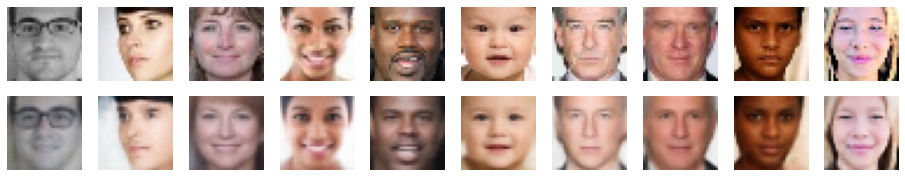

1482/1482 [==============================] - 201s 136ms/step - loss: 121.3658 - sequential_9_loss: 79.7390 - latent-mean-and-log-var_loss: 83.2535
Original samples and reconstruction at epoch 89:


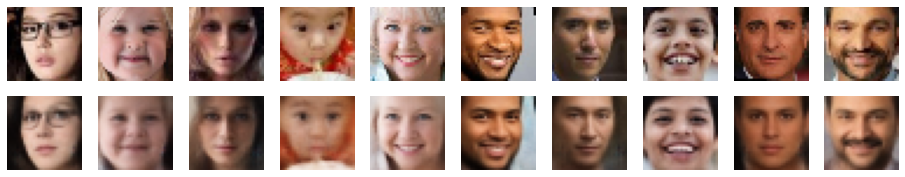

1482/1482 [==============================] - 201s 136ms/step - loss: 121.2543 - sequential_9_loss: 79.6139 - latent-mean-and-log-var_loss: 83.2808
Original samples and reconstruction at epoch 90:


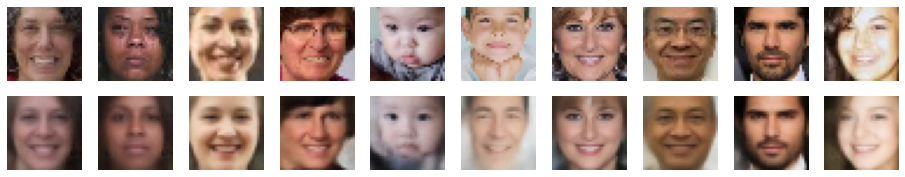

1482/1482 [==============================] - 202s 136ms/step - loss: 121.1848 - sequential_9_loss: 79.4909 - latent-mean-and-log-var_loss: 83.3876
Original samples and reconstruction at epoch 91:


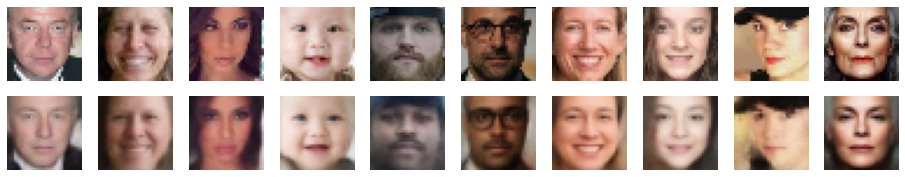

1482/1482 [==============================] - 202s 137ms/step - loss: 121.0222 - sequential_9_loss: 79.3677 - latent-mean-and-log-var_loss: 83.3092
Original samples and reconstruction at epoch 92:


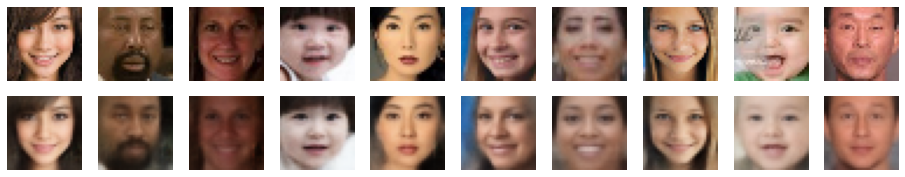

1482/1482 [==============================] - 202s 136ms/step - loss: 120.8084 - sequential_9_loss: 79.1740 - latent-mean-and-log-var_loss: 83.2687
Original samples and reconstruction at epoch 93:


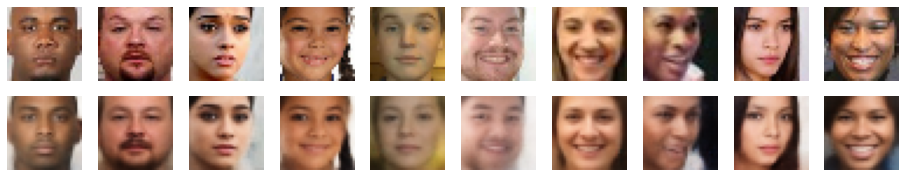

1482/1482 [==============================] - 201s 136ms/step - loss: 120.8242 - sequential_9_loss: 79.1173 - latent-mean-and-log-var_loss: 83.4133
Original samples and reconstruction at epoch 94:


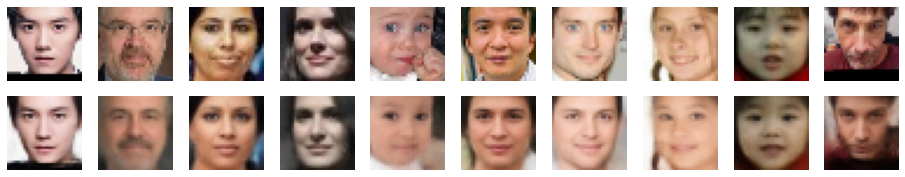

1482/1482 [==============================] - 201s 136ms/step - loss: 120.5663 - sequential_9_loss: 78.8885 - latent-mean-and-log-var_loss: 83.3559
Original samples and reconstruction at epoch 95:


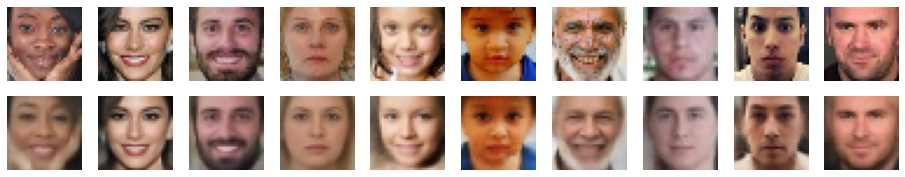

1482/1482 [==============================] - 201s 136ms/step - loss: 120.4200 - sequential_9_loss: 78.7800 - latent-mean-and-log-var_loss: 83.2799
Original samples and reconstruction at epoch 96:


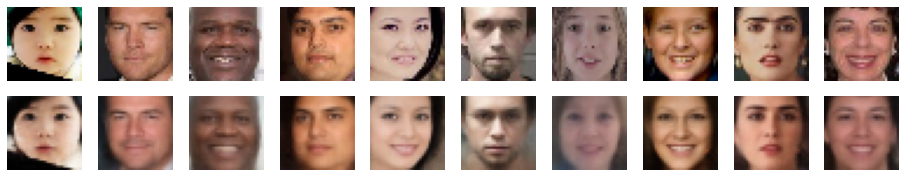

1482/1482 [==============================] - 202s 136ms/step - loss: 120.4105 - sequential_9_loss: 78.6986 - latent-mean-and-log-var_loss: 83.4238
Original samples and reconstruction at epoch 97:


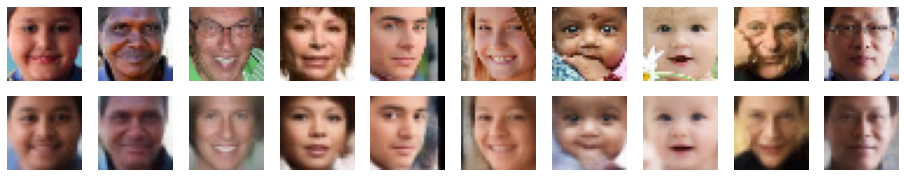

1482/1482 [==============================] - 202s 137ms/step - loss: 120.2736 - sequential_9_loss: 78.5670 - latent-mean-and-log-var_loss: 83.4134
Original samples and reconstruction at epoch 98:


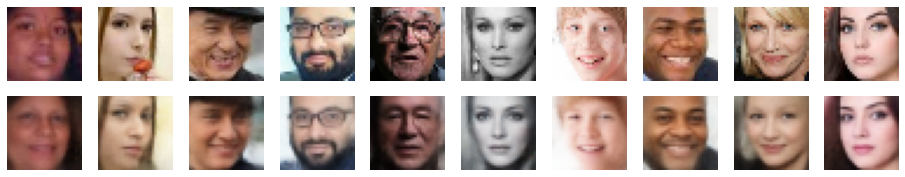

1482/1482 [==============================] - 202s 136ms/step - loss: 120.1570 - sequential_9_loss: 78.4081 - latent-mean-and-log-var_loss: 83.4980
Original samples and reconstruction at epoch 99:


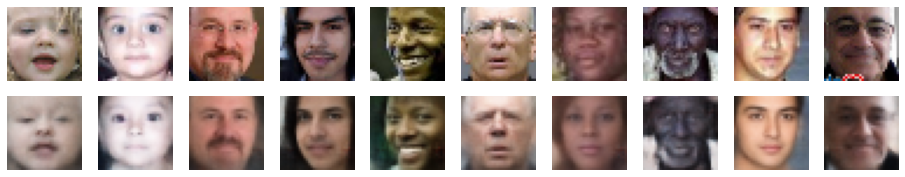

In [44]:
EPOCHS = 100

for epoch in range(EPOCHS):
    encoder_decoder.fit(X_train, [X_train, np.zeros((X_train.shape[0], 2*LATENT_DIM))], batch_size=32, epochs=1)
    print(f"Original samples and reconstruction at epoch {epoch}:")
    plot_reconstructions(encoder_decoder, X_train)

Face interpolations:


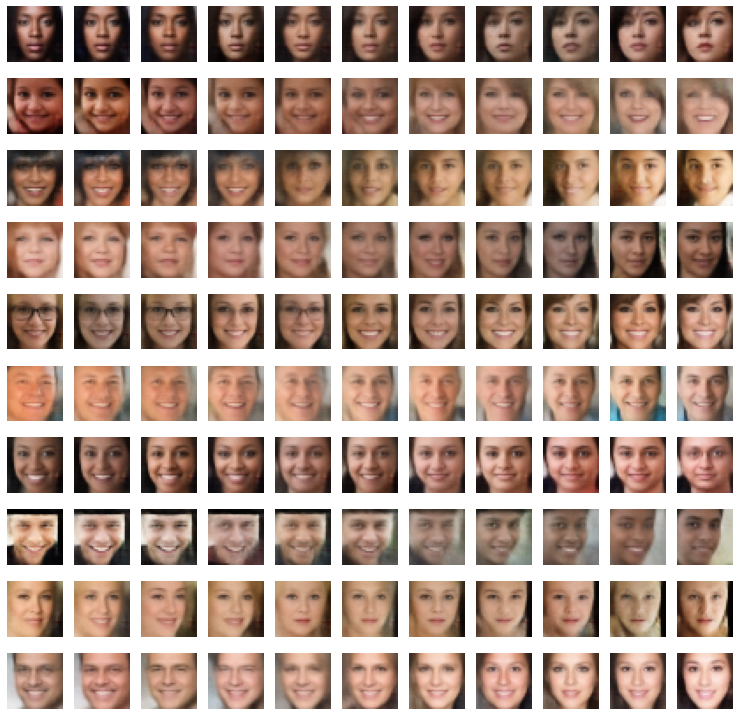

In [58]:
print("Face interpolations:")
plt.figure(figsize=(13, 13))
for row in range(10):
    latent_a, latent_b = encoder(tf.gather(X_train, np.random.randint(0, len(X_train), size=2)))
    interpolated_latent = np.asarray([fraction * latent_a + (1-fraction) * latent_b for fraction in np.arange(0, 1.1, 0.1)])
    faces = 0.5 * decoder.predict(interpolated_latent) + 0.5

    for col in range(11):
        ax = plt.subplot(10,11,11*row + col + 1)
        ax.imshow(faces[col])
        ax.axis("off")
plt.show()